In [1]:
# notebook formatter
import jupyter_black

jupyter_black.load()

In [2]:
import os
import glob
import itertools
import pandas as pd
from scegot import scEGOT

In [3]:
DATASET_INPUT_ROOT_PATH = os.path.join(os.getcwd(), "dataset/input/")

In [4]:
RANDOM_STATE = 2022
PCA_N_COMPONENTS = 30
GMM_CLUSTER_NUMBERS = [1, 2, 4, 5, 5]
UMAP_N_NEIGHBORS = 1000
UMAP_N_COMPONENTS = 2
DAY_NAMES = ["day 0", "day 0.5", "day 1", "day 1.5", "day 2"]

In [5]:
input_file_paths = sorted(glob.glob(f"{DATASET_INPUT_ROOT_PATH}usedataSmall/*.csv"))
input_data = [
    pd.read_csv(input_file_path, index_col=0) for input_file_path in input_file_paths
]
print(f"number of days: {len(input_data)}")
print("shape of each day's data:")
for i, data in enumerate(input_data):
    print(f"    {DAY_NAMES[i]}: {data.shape}")
print("data example: ")
input_data[0].head()

number of days: 5
shape of each day's data:
    day 0: (4943, 2000)
    day 0.5: (1981, 2000)
    day 1: (551, 2000)
    day 1.5: (2562, 2000)
    day 2: (1753, 2000)
data example: 


,APOA1,ACTC1,CST1,KRT19,CALCB,GAL,CRH,APOA2,PLA2G2A,CTSV,...,PRICKLE1,RPL39L,PRR13,SYNE2,LOX,BTG2,FXYD4,YY1,AKR1D1,ZFHX3
iM_AAACCCACAACAACAA-1,0,5,0,23,0,105,0,0,0,9,...,2,18,4,11,0,0,0,17,0,0
iM_AAACGAAAGCTAGTTC-1,1,21,0,28,1,37,0,0,0,11,...,1,14,9,3,0,4,0,15,0,2
iM_AAACGAATCCTGCCAT-1,0,1,0,15,0,236,0,0,0,6,...,0,14,8,3,0,1,0,9,0,2
iM_AAACGAATCGACGATT-1,0,31,1,9,0,18,0,0,0,9,...,1,5,9,6,0,0,0,13,0,1
iM_AAACGAATCGCGGTAC-1,0,18,0,5,0,61,0,0,0,2,...,0,8,5,2,0,0,0,5,0,0


In [6]:
tf_gene_names = (
    pd.read_csv(
        f"{DATASET_INPUT_ROOT_PATH}TF_genes/TFgenes_name.csv", header=None, index_col=0
    )
    .T["cell"]
    .values
)
tf_gene_names

array(['ZBTB8B', 'GSX2', 'TBX2', ..., 'NME2', 'ZNF488', 'ZNF280B'],
      dtype=object)

# Tutorial

In [142]:
import sys

del sys.modules["scegot"]

from scegot import scEGOT

In [143]:
scegot = scEGOT(
    input_data,
    PCA_N_COMPONENTS,
    GMM_CLUSTER_NUMBERS,
    day_names=["day 0", "day 0.5", "day 1", "day 1.5", "day 2"],
    verbose=True,
    target_sum=1e5,
)

In [144]:
scegot.X_raw = input_data
scegot.X_pca = X
scegot.pca_model = pca_model
scegot.gmm_models = gmm_models
scegot.gmm_labels = gmm_labels
scegot.X_umap = X_2
scegot.umap_model = umap_model
scegot.X_normalized = X_normalized

## Preprocess

In [22]:
%%time
X, pca_model = scegot.preprocess(RANDOM_STATE, RANDOM_STATE)

Ex. X_new = screcode.RECODE(fast_algorithm=False).fit_transform(X)


Applying scRECODE...
start RECODE for scRNA-seq
end RECODE for scRNA-seq
log: {'seq_target': 'RNA', '#significant genes': 1987, '#non-significant genes': 10, '#silent genes': 0, 'ell': 492, 'Elapsed time': '0h 0m 45s 767ms'}
Applying UMI normalization...
Applying log1p normalization...
Applying PCA...
	sum of explained_variance_ratio = 69.68427484975997
CPU times: user 4min 24s, sys: 11.9 s, total: 4min 36s
Wall time: 56.6 s


In [23]:
X_normalized = scegot.X_normalized

## GMM

### PCA ver.

In [11]:
%%time
gmm_models, gmm_labels = scegot.fit_predict_gmm(random_state=RANDOM_STATE)

100%|██████████| 5/5 [04:50<00:00, 58.18s/it]

CPU times: user 33min 44s, sys: 1min 22s, total: 35min 6s
Wall time: 4min 50s


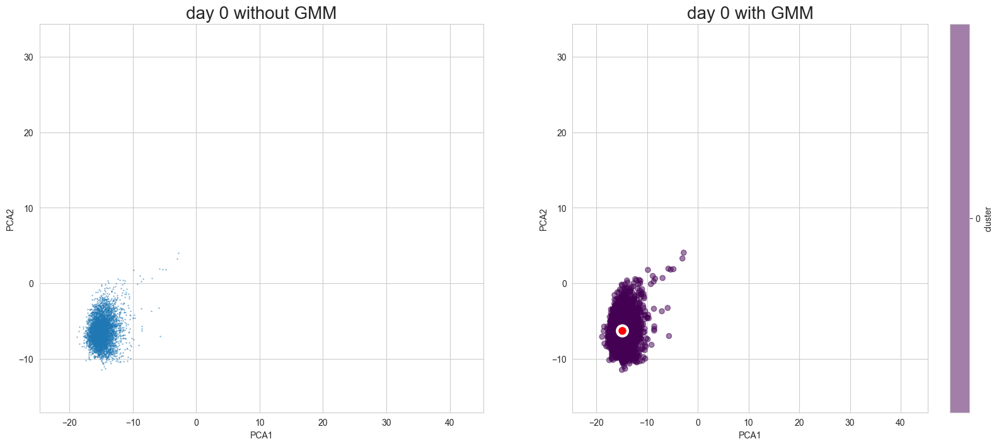

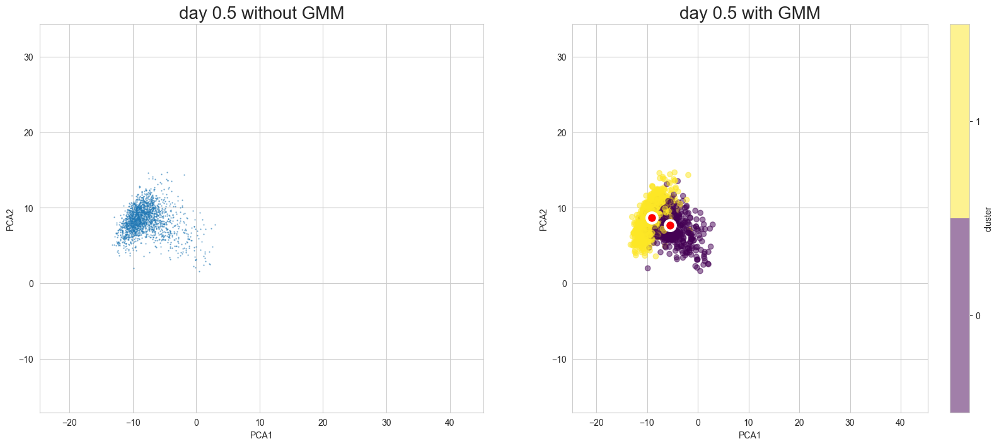

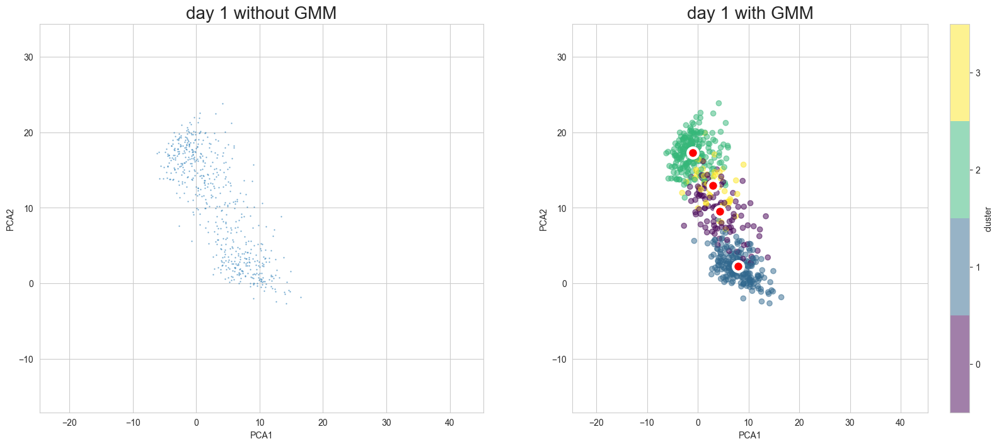

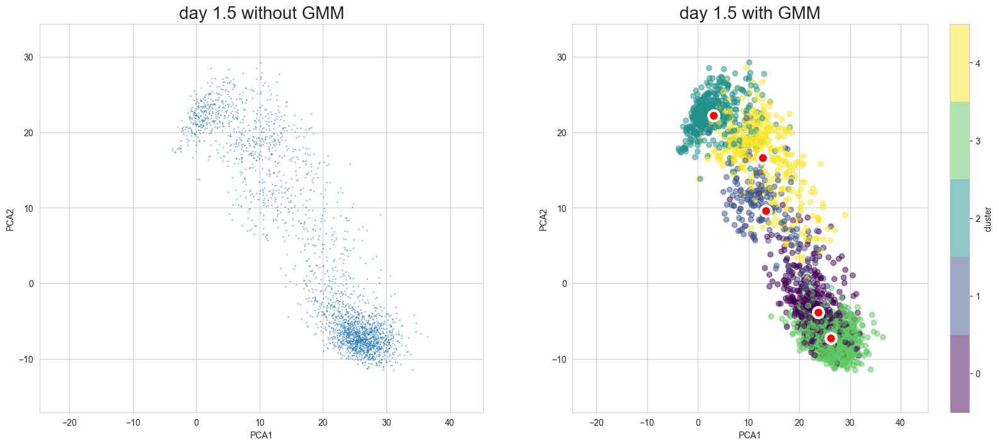

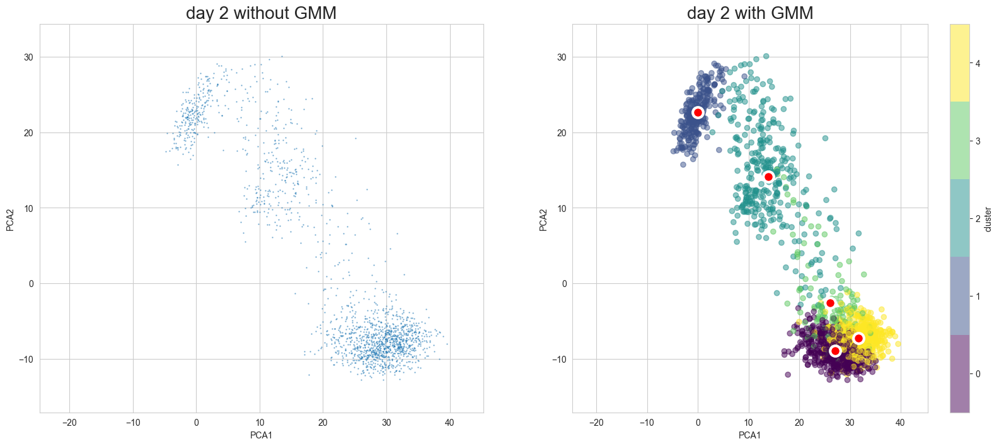

In [12]:
scegot.plot_gmm_predictions(
    plot_gmm_means=True,
    figure_titles_without_gmm=[f"{name} without GMM" for name in DAY_NAMES],
    figure_titles_with_gmm=[f"{name} with GMM" for name in DAY_NAMES],
    cmap="viridis",
    save=True,
    save_paths=[f"./output/library/PCA_GMM_figure_{name}.png" for name in DAY_NAMES],
)

### UMAP ver.

In [13]:
%%time
scegot.umap_n_components = UMAP_N_COMPONENTS
scegot.umap_n_neighbors = UMAP_N_NEIGHBORS
X_2, umap_model = scegot.apply_umap(random_state=RANDOM_STATE)

CPU times: user 2min 2s, sys: 1.82 s, total: 2min 4s
Wall time: 50.3 s


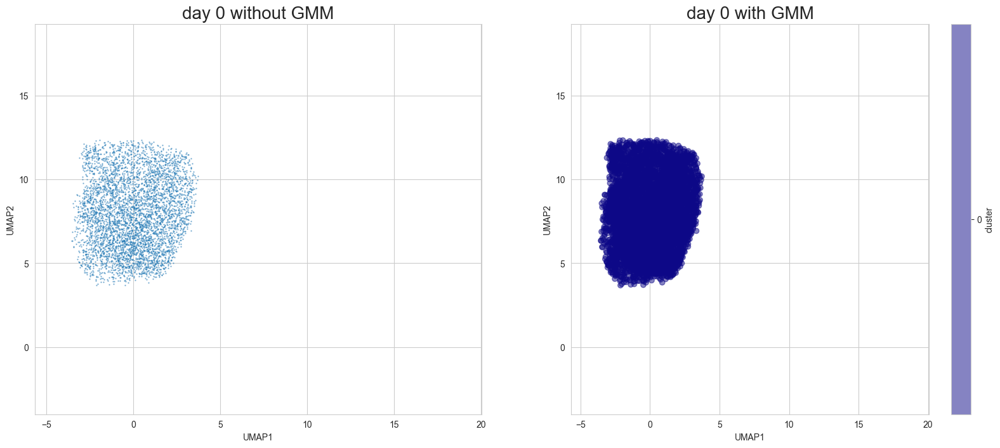

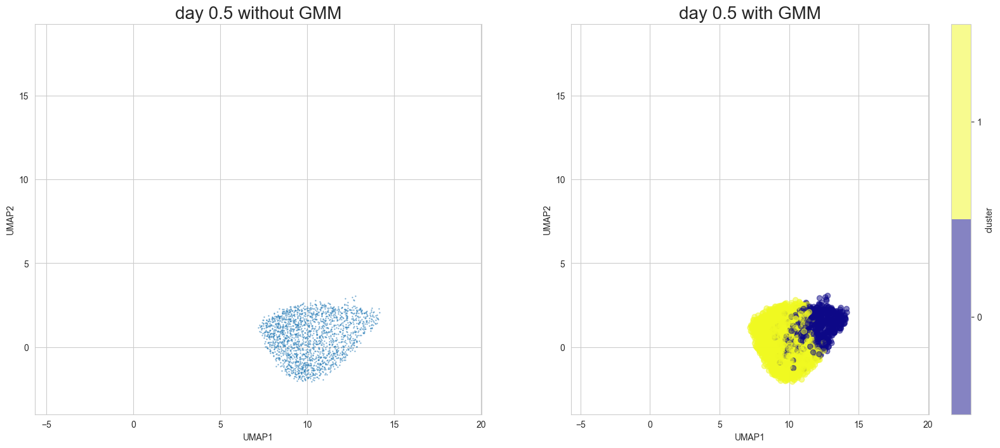

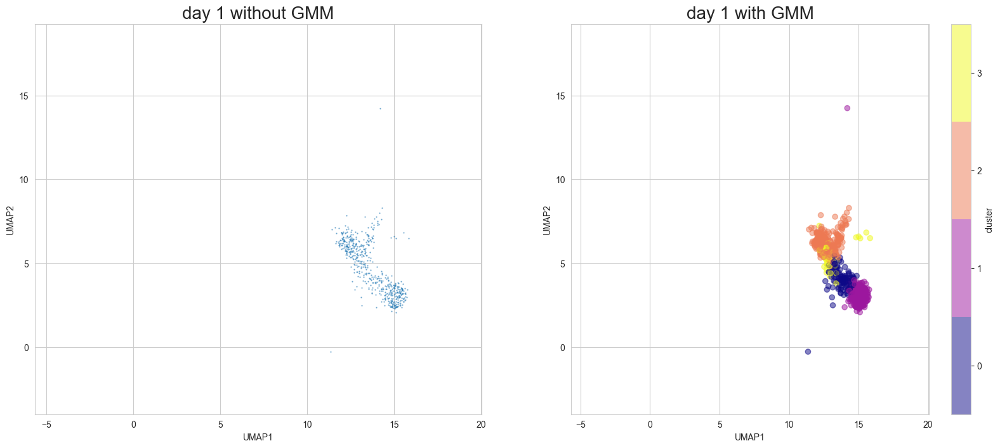

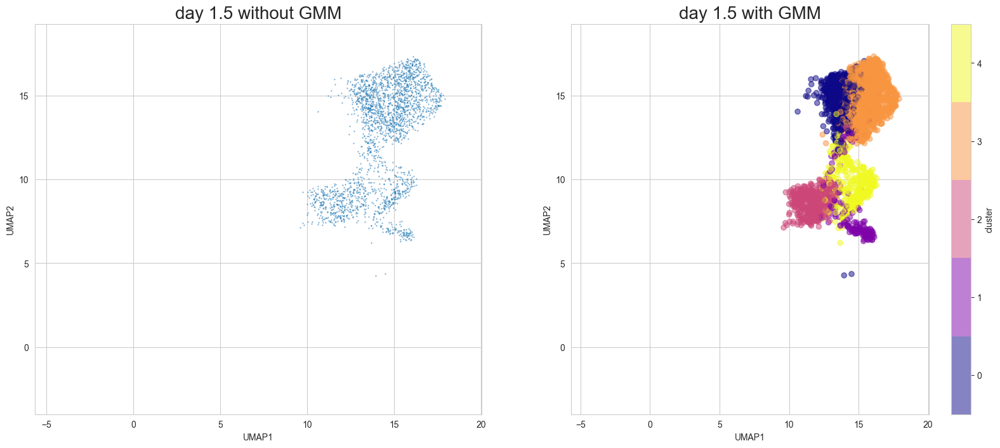

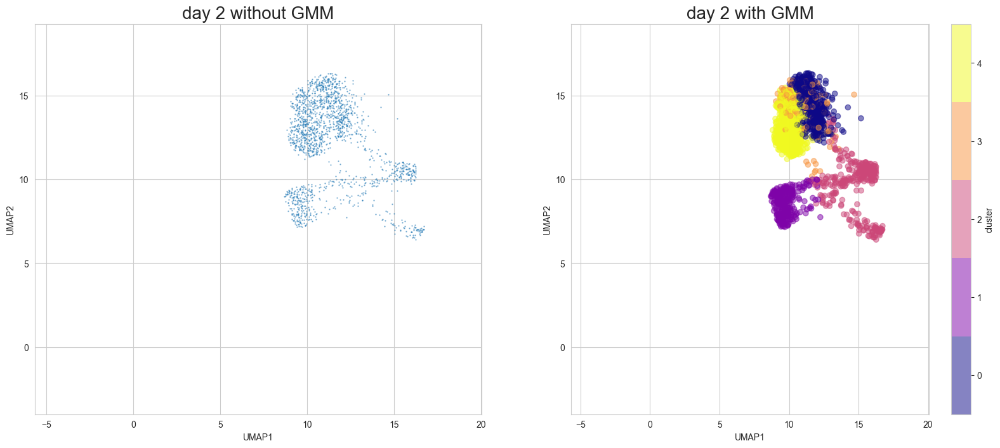

In [14]:
scegot.plot_gmm_predictions(
    mode="UMAP",
    figure_titles_without_gmm=[f"{name} without GMM" for name in DAY_NAMES],
    figure_titles_with_gmm=[f"{name} with GMM" for name in DAY_NAMES],
    cmap="plasma",
    save=True,
    save_paths=[f"./output/library/UMAP_GMM_figure_{name}.png" for name in DAY_NAMES],
)

## Cell State

### Movie

Interpolating between day 0 and day 0.5...


  0%|          | 0/11 [00:00<?, ?it/s]

100%|██████████| 11/11 [00:04<00:00,  2.53it/s]


Interpolating between day 0.5 and day 1...


100%|██████████| 11/11 [00:07<00:00,  1.49it/s]


Interpolating between day 1 and day 1.5...


  0%|          | 0/11 [00:00<?, ?it/s]/Users/momo/.pyenv/versions/3.8.16/envs/scEGOT/lib/python3.8/site-packages/ot/bregman.py:1112: UserWarning:

Sinkhorn did not converge. You might want to increase the number of iterations `numItermax` or the regularization parameter `reg`.

100%|██████████| 11/11 [00:20<00:00,  1.85s/it]


Interpolating between day 1.5 and day 2...


100%|██████████| 11/11 [00:11<00:00,  1.09s/it]


Creating animation...


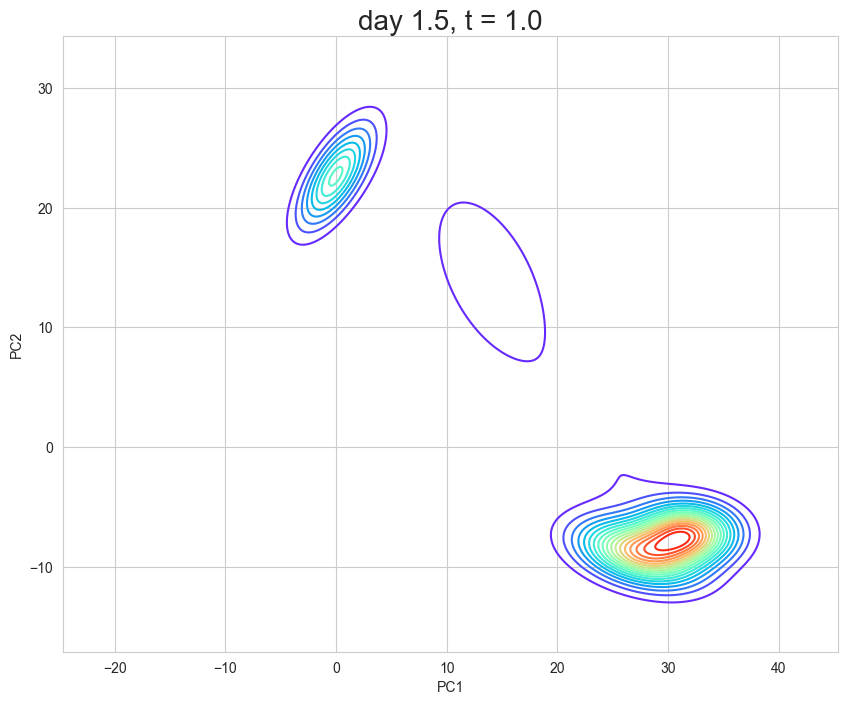

In [77]:
scegot.animate_cell_state(
    cmap="rainbow",
    save=True,
    save_path="./output/library/cell_state_video.gif",
)

### Graph

In [25]:
cluster_names = scegot.generate_cluster_names_with_day()

#### PCA ver.

In [145]:
G = scegot.make_cell_state_graph(cluster_names)
scegot.plot_cell_state_graph(
    G,
    cluster_names,
    tf_gene_names,
    save=True,
    save_path="./output/library/cell_state_graph_PCA.png",
)

/Users/momo/.pyenv/versions/3.8.16/envs/scEGOT/lib/python3.8/site-packages/ot/bregman.py:1112: UserWarning:

Sinkhorn did not converge. You might want to increase the number of iterations `numItermax` or the regularization parameter `reg`.



/Users/momo/.pyenv/versions/3.8.16/envs/scEGOT/lib/python3.8/site-packages/ot/bregman.py:1112: UserWarning:

Sinkhorn did not converge. You might want to increase the number of iterations `numItermax` or the regularization parameter `reg`.



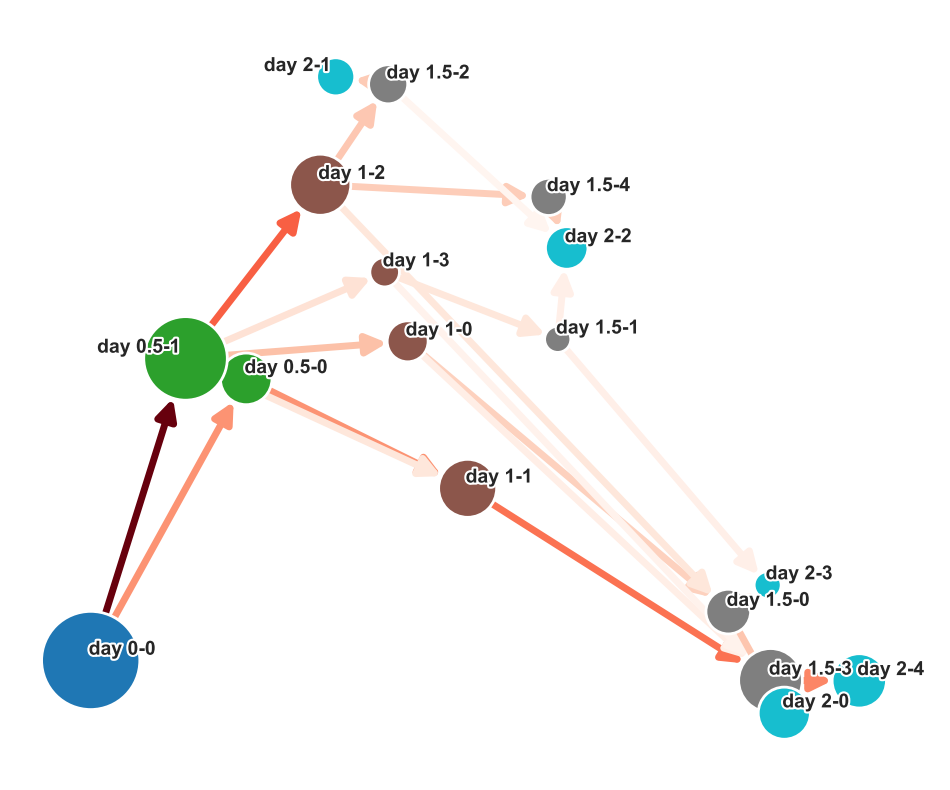

In [146]:
G = scegot.make_cell_state_graph(cluster_names)
scegot.plot_simple_cell_state_graph(
    G,
    save=True,
    save_path="./output/library/simple_cell_state_graph.png",
)

/Users/momo/.pyenv/versions/3.8.16/envs/scEGOT/lib/python3.8/site-packages/ot/bregman.py:1112: UserWarning:

Sinkhorn did not converge. You might want to increase the number of iterations `numItermax` or the regularization parameter `reg`.



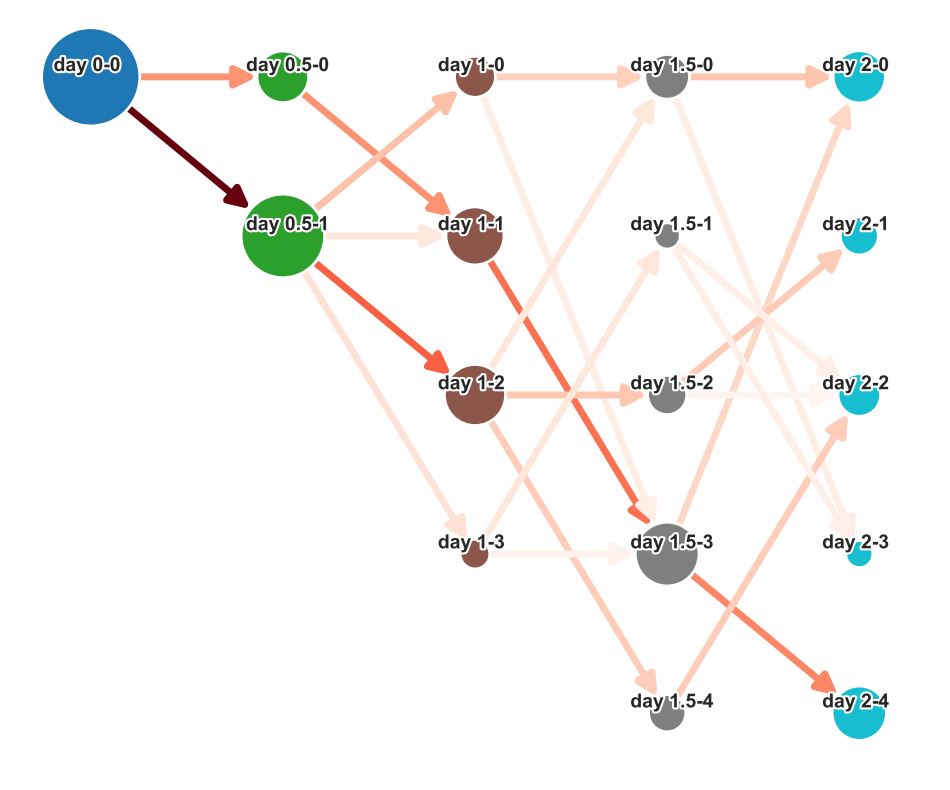

In [147]:
G = scegot.make_cell_state_graph(cluster_names)
scegot.plot_simple_cell_state_graph(
    G,
    plot_type="align",
    save=True,
    save_path="./output/library/simple_cell_state_graph_align.png",
)

#### UMAP ver.

In [58]:
G_umap, cell_state_edge_list_umap = scegot.make_cell_state_graph(
    cluster_names, mode="umap"
)
scegot.plot_cell_state_graph(
    G_umap,
    cell_state_edge_list_umap,
    cluster_names,
    tf_gene_names,
    save=True,
    save_path="./output/library/cell_state_graph_UMAP.png",
)

/Users/momo/.pyenv/versions/3.8.16/envs/scEGOT/lib/python3.8/site-packages/ot/bregman.py:1112: UserWarning:

Sinkhorn did not converge. You might want to increase the number of iterations `numItermax` or the regularization parameter `reg`.

/Users/momo/dev/ASHBi/scEGOT/scEGOT/scEGOT/scegot.py:548: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

/Users/momo/dev/ASHBi/scEGOT/scEGOT/scEGOT/scegot.py:548: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

/Users/momo/dev/ASHBi/scEGOT/scEGOT/scEGOT/scegot.py:548: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

/Users/momo/dev/ASHBi/scEGOT/scEGOT/scEGOT/scegot.py:548: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.conc

/Users/momo/.pyenv/versions/3.8.16/envs/scEGOT/lib/python3.8/site-packages/ot/bregman.py:1112: UserWarning:

Sinkhorn did not converge. You might want to increase the number of iterations `numItermax` or the regularization parameter `reg`.



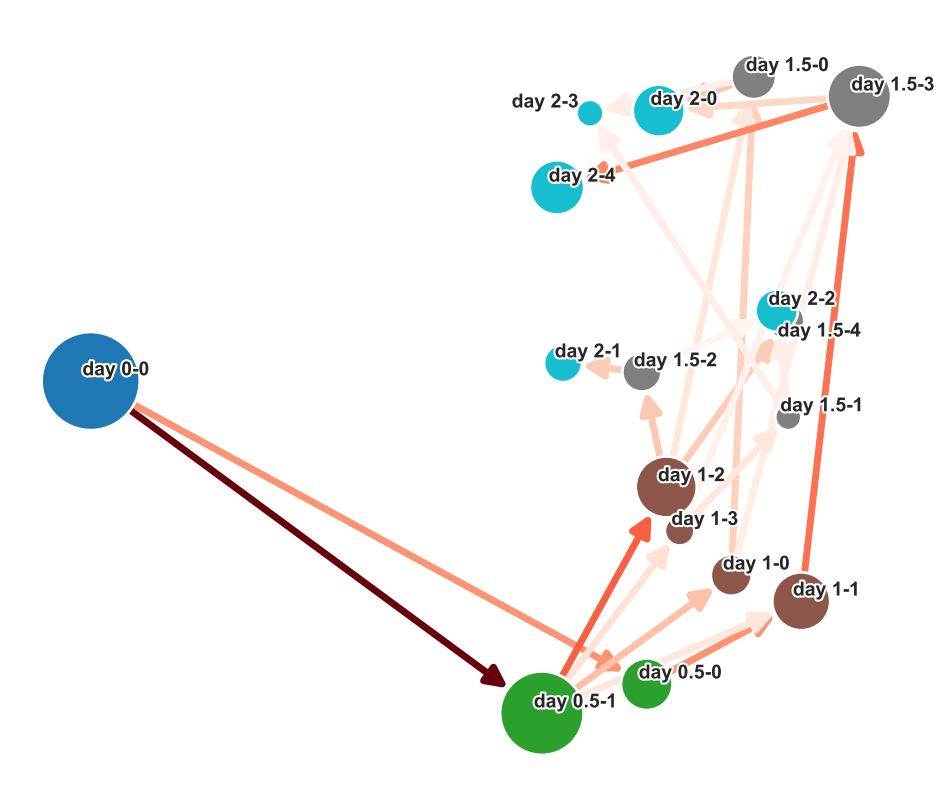

In [59]:
G_umap, cell_state_edge_list_umap = scegot.make_cell_state_graph(
    cluster_names, mode="umap"
)
scegot.plot_simple_cell_state_graph(
    G_umap,
    save=True,
    save_path="./output/library/simple_cell_state_graph_UMAP.png",
)

## Fold Change

In [60]:
scegot.plot_fold_change(
    cluster_names,
    tf_gene_names,
    "day 0.5-0",
    "day 0.5-1",
    threshold=1.0,
    save=True,
    save_path="./output/library/fold_change.png",
)

## Pathway

In [61]:
# selected_genes = ['HAND1','FOXF1','MESP1','EOMES']
pathway_names = [
    "day 0-0",
    "day 0.5-1",
    "day 1-1",
    "day 1.5-4",
    "day 2-2",
]
selected_genes = ["NANOG", "SOX17", "TFAP2C", "NKX1-2"]
scegot.plot_pathway_gene_expressions(
    cluster_names,
    tf_gene_names,
    pathway_names,
    selected_genes,
    save=True,
    save_path="./output/library/pathway_gene_expressions.png",
)

## Features of single gene

### PCA ver.

In [64]:
gene_name = "NKX1-2"
scegot.plot_pathway_single_gene_2d(
    gene_name,
    save=True,
    save_path="./output/library/single_gene_2d.png",
)

In [65]:
scegot.plot_pathway_single_gene_3d(
    gene_name,
    save=True,
    save_path="./output/library/single_gene_3d.html",
)

### UMAP ver.

In [66]:
gene_name = "NKX1-2"
scegot.plot_pathway_single_gene_2d(gene_name, mode="UMAP")

## Interpolation

### PCA ver.

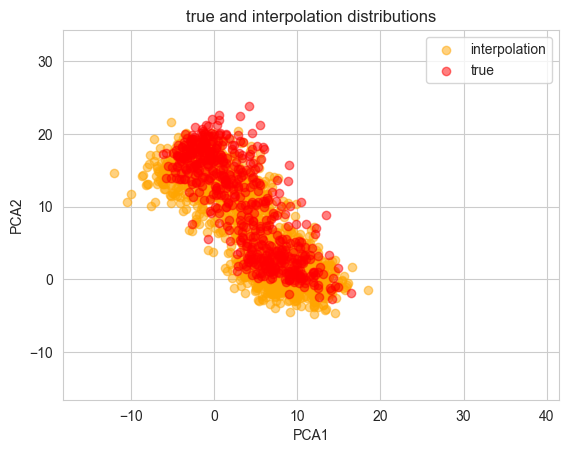

<Figure size 640x480 with 0 Axes>

In [67]:
scegot.plot_true_and_interpolation_distributions(
    2,
    plot_source_and_target=False,
    alpha_true=0.5,
    save=True,
    save_path="./output/library/true_interpolation_distributions_without_source_target.png",
)

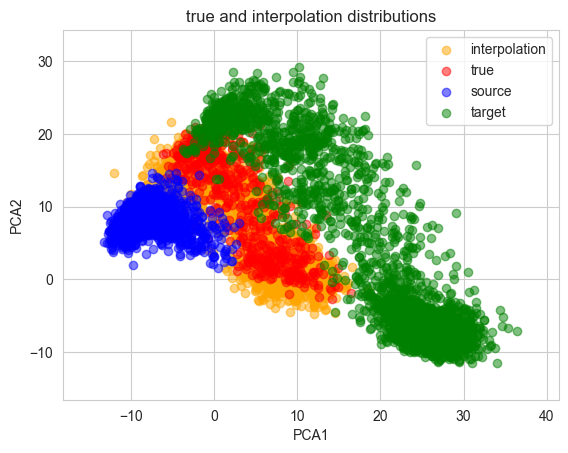

<Figure size 640x480 with 0 Axes>

In [68]:
scegot.plot_true_and_interpolation_distributions(
    2,
    alpha_true=0.5,
    save=True,
    save_path="./output/library/true_interpolation_distributions.png",
)

Interpolating between day 0 and day 0.5...


100%|██████████| 11/11 [00:00<00:00, 15.56it/s]


Interpolating between day 0.5 and day 1...


100%|██████████| 11/11 [00:00<00:00, 12.89it/s]


Interpolating between day 1 and day 1.5...


  0%|          | 0/11 [00:00<?, ?it/s]/Users/momo/.pyenv/versions/3.8.16/envs/scEGOT/lib/python3.8/site-packages/ot/bregman.py:1112: UserWarning:

Sinkhorn did not converge. You might want to increase the number of iterations `numItermax` or the regularization parameter `reg`.

100%|██████████| 11/11 [00:01<00:00,  9.84it/s]


Interpolating between day 1.5 and day 2...


100%|██████████| 11/11 [00:01<00:00,  7.89it/s]


Creating animation...


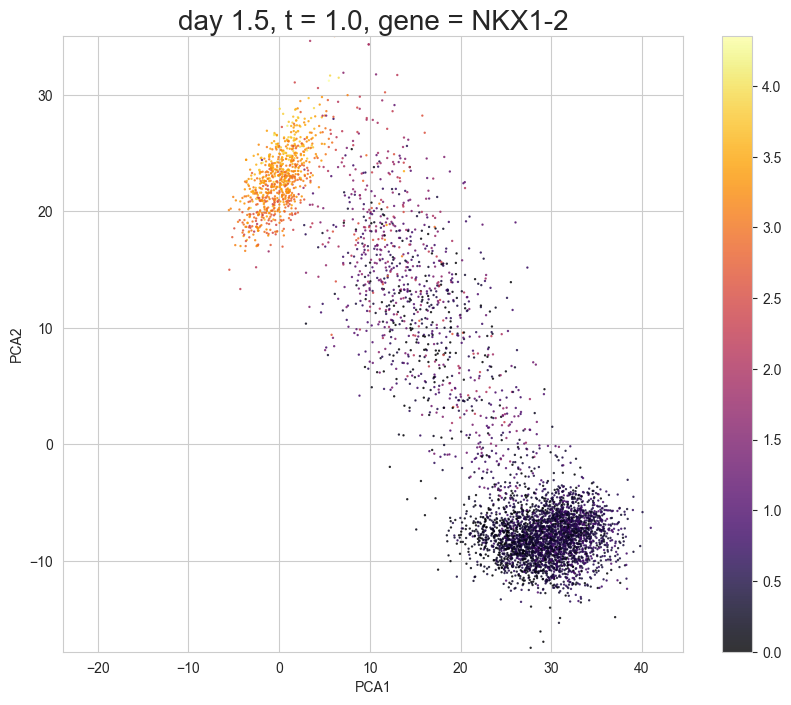

In [78]:
target_gene = "NKX1-2"
scegot.animate_interpolation(
    target_gene,
    interpolate_interval=11,
    cmap="inferno",
    save=True,
    save_path="./output/library/interpolation_video.gif",
)

### umap ver.

Transforming interpolated data with UMAP...


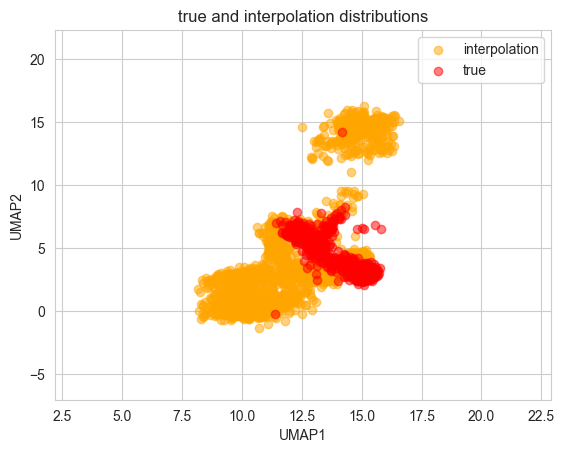

<Figure size 640x480 with 0 Axes>

In [79]:
scegot.plot_true_and_interpolation_distributions(
    2,
    plot_source_and_target=False,
    alpha_true=0.5,
    mode="umap",
    save=True,
    save_path="./output/library/true_interpolation_distributions_without_source_target_umap.png",
)

Transforming interpolated data with UMAP...


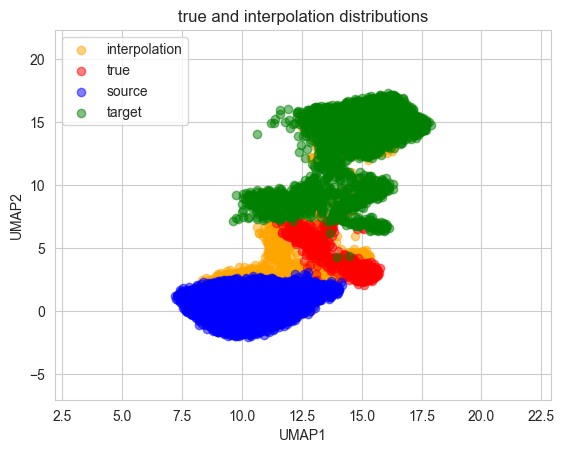

<Figure size 640x480 with 0 Axes>

In [80]:
scegot.plot_true_and_interpolation_distributions(
    2,
    alpha_true=0.5,
    mode="umap",
    save=True,
    save_path="./output/library/true_interpolation_distributions_umap.png",
)

  0%|          | 0/11 [00:00<?, ?it/s]/Users/momo/.pyenv/versions/3.8.16/envs/scEGOT/lib/python3.8/site-packages/ot/bregman.py:1112: UserWarning:

Sinkhorn did not converge. You might want to increase the number of iterations `numItermax` or the regularization parameter `reg`.

  9%|▉         | 1/11 [00:26<04:28, 26.85s/it]/Users/momo/.pyenv/versions/3.8.16/envs/scEGOT/lib/python3.8/site-packages/ot/bregman.py:1112: UserWarning:

Sinkhorn did not converge. You might want to increase the number of iterations `numItermax` or the regularization parameter `reg`.

 18%|█▊        | 2/11 [00:53<04:03, 27.02s/it]/Users/momo/.pyenv/versions/3.8.16/envs/scEGOT/lib/python3.8/site-packages/ot/bregman.py:1112: UserWarning:

Sinkhorn did not converge. You might want to increase the number of iterations `numItermax` or the regularization parameter `reg`.

 27%|██▋       | 3/11 [01:21<03:36, 27.08s/it]/Users/momo/.pyenv/versions/3.8.16/envs/scEGOT/lib/python3.8/site-packages/ot/bregman.py:1112: UserWa

CPU times: user 21min 9s, sys: 22.2 s, total: 21min 31s
Wall time: 20min 22s


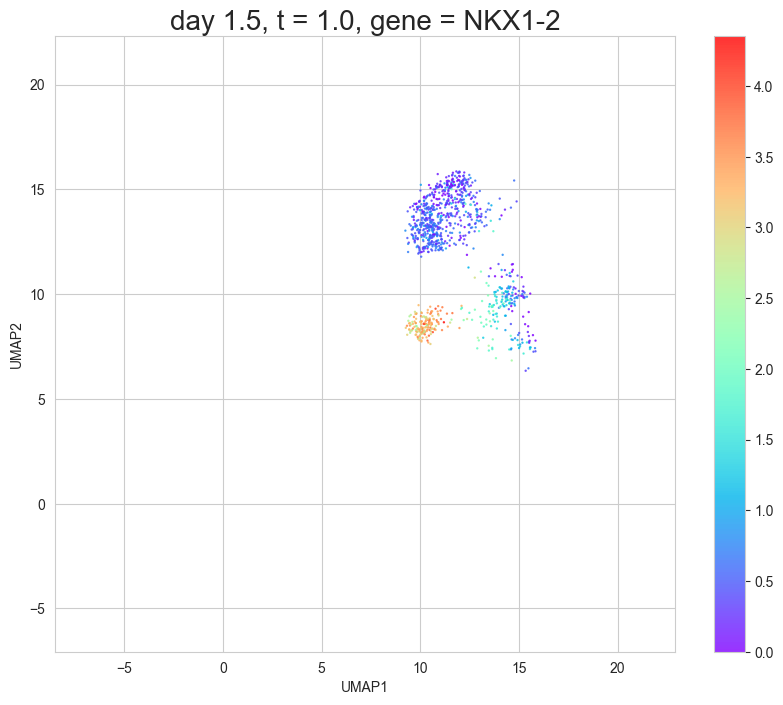

In [135]:
%%time
target_gene = "NKX1-2"
scegot.animate_interpolation(
    target_gene,
    interpolate_interval=11,
    n_samples=1000,
    mode="umap",
    save=True,
    save_path="./output/library/interpolation_video_umap.gif",
)

## Cell velocity

### PCA ver.

In [91]:
velocities = scegot.calculate_cell_velocities()

/Users/momo/.pyenv/versions/3.8.16/envs/scEGOT/lib/python3.8/site-packages/ot/bregman.py:1112: UserWarning:

Sinkhorn did not converge. You might want to increase the number of iterations `numItermax` or the regularization parameter `reg`.



Calculating cell velocities between each day...


 50%|█████     | 2/4 [00:00<00:00,  2.43it/s]/Users/momo/dev/ASHBi/scEGOT/scEGOT/scEGOT/scegot.py:1432: RuntimeWarning:

divide by zero encountered in log

/Users/momo/dev/ASHBi/scEGOT/scEGOT/scEGOT/scegot.py:1432: RuntimeWarning:

divide by zero encountered in log

/Users/momo/dev/ASHBi/scEGOT/scEGOT/scEGOT/scegot.py:1432: RuntimeWarning:

divide by zero encountered in log

 75%|███████▌  | 3/4 [00:02<00:00,  1.15it/s]/Users/momo/dev/ASHBi/scEGOT/scEGOT/scEGOT/scegot.py:1432: RuntimeWarning:

divide by zero encountered in log

/Users/momo/dev/ASHBi/scEGOT/scEGOT/scEGOT/scegot.py:1432: RuntimeWarning:

divide by zero encountered in log

/Users/momo/dev/ASHBi/scEGOT/scEGOT/scEGOT/scegot.py:1432: RuntimeWarning:

divide by zero encountered in log

100%|██████████| 4/4 [00:04<00:00,  1.00s/it]


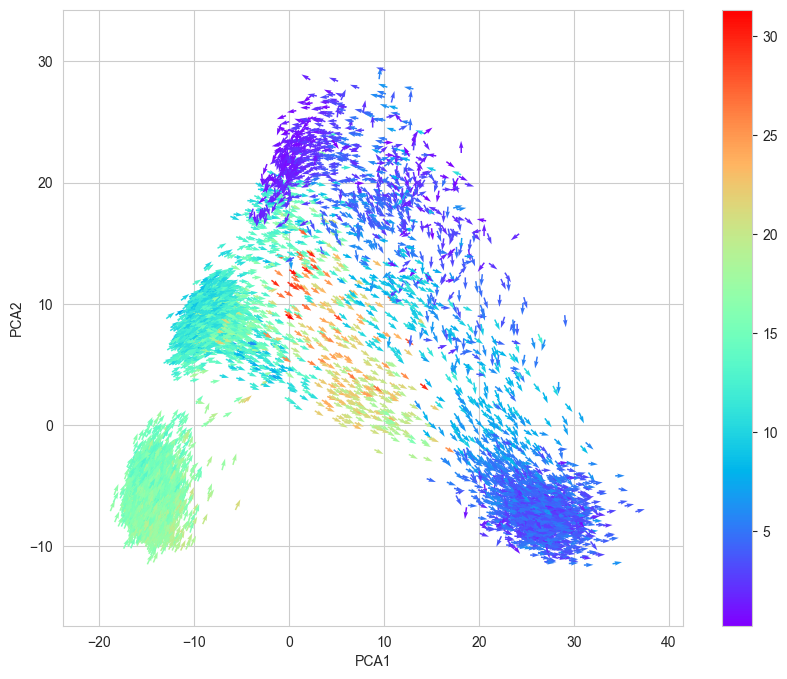

<Figure size 640x480 with 0 Axes>

In [82]:
scegot.plot_cell_velocity(
    velocities,
    cmap="rainbow",
    save=True,
    save_path="./output/library/cell_velocity_PCA.png",
)

In [83]:
cluster_names = scegot.generate_cluster_names_with_day()
cluster_names

[['day 0-0'],
 ['day 0.5-0', 'day 0.5-1'],
 ['day 1-0', 'day 1-1', 'day 1-2', 'day 1-3'],
 ['day 1.5-0', 'day 1.5-1', 'day 1.5-2', 'day 1.5-3', 'day 1.5-4'],
 ['day 2-0', 'day 2-1', 'day 2-2', 'day 2-3', 'day 2-4']]

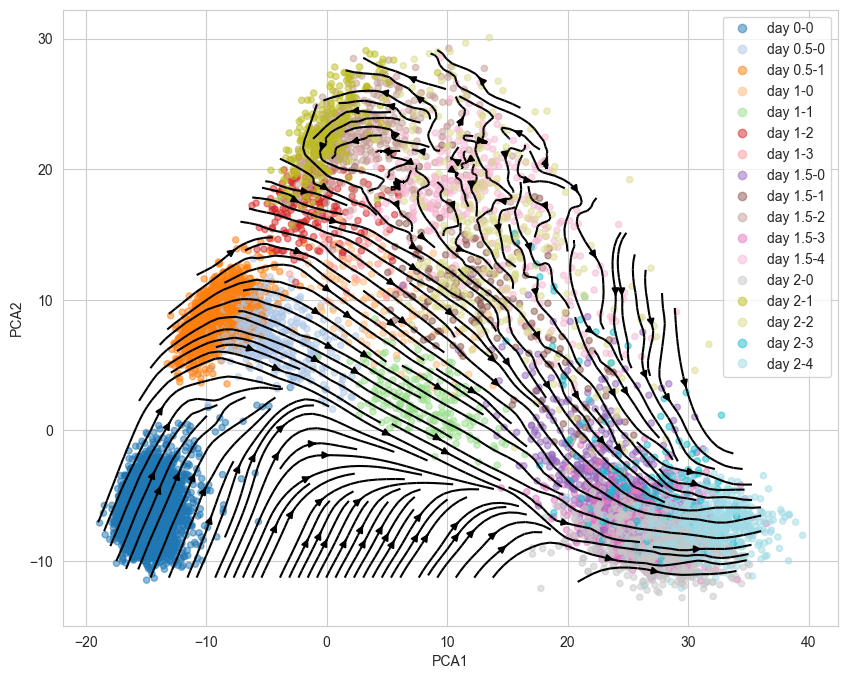

<Figure size 640x480 with 0 Axes>

In [84]:
scegot.plot_interpolation_of_cell_velocity(
    velocities,
    cluster_names=list(itertools.chain.from_iterable(cluster_names)),
    cmap="tab20",
    save=True,
    save_path="./output/library/cell_velocity_interpolation_gmm_clusters_all_days.png",
)

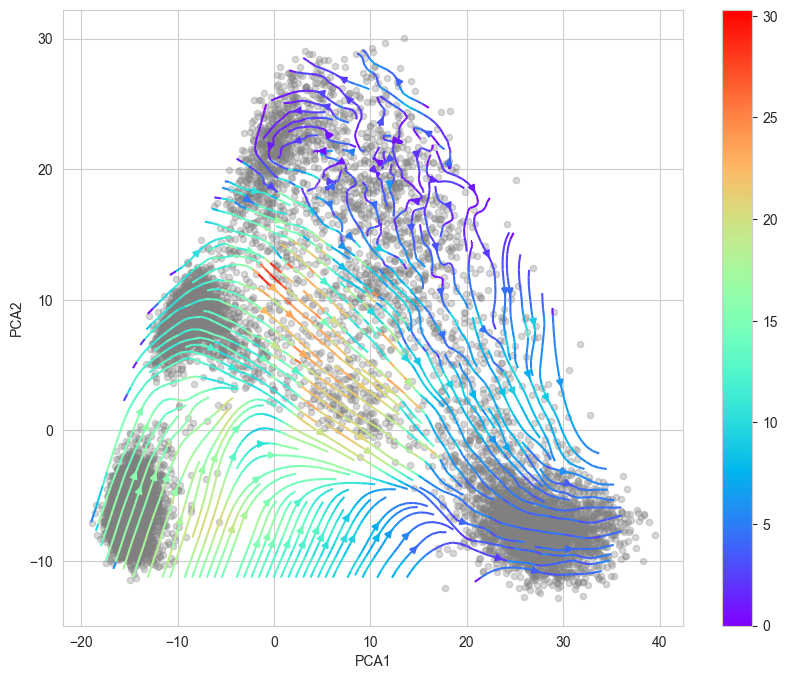

<Figure size 640x480 with 0 Axes>

In [85]:
scegot.plot_interpolation_of_cell_velocity(
    velocities,
    color_streams=True,
    color_points=None,
    cmap="rainbow",
    save=True,
    save_path="./output/library/cell_velocity_interpolation_all_days.png",
)

### UMAP ver.

In [92]:
%%time
velocities_umap = scegot.calculate_cell_velocities(mode="umap")

Calculating cell velocities between each day...


 50%|█████     | 2/4 [03:32<03:16, 98.08s/it] /Users/momo/dev/ASHBi/scEGOT/scEGOT/scEGOT/scegot.py:1432: RuntimeWarning:

divide by zero encountered in log

/Users/momo/dev/ASHBi/scEGOT/scEGOT/scEGOT/scegot.py:1432: RuntimeWarning:

divide by zero encountered in log

/Users/momo/dev/ASHBi/scEGOT/scEGOT/scEGOT/scegot.py:1432: RuntimeWarning:

divide by zero encountered in log

 75%|███████▌  | 3/4 [03:50<01:01, 61.74s/it]/Users/momo/dev/ASHBi/scEGOT/scEGOT/scEGOT/scegot.py:1432: RuntimeWarning:

divide by zero encountered in log

/Users/momo/dev/ASHBi/scEGOT/scEGOT/scEGOT/scegot.py:1432: RuntimeWarning:

divide by zero encountered in log

/Users/momo/dev/ASHBi/scEGOT/scEGOT/scEGOT/scegot.py:1432: RuntimeWarning:

divide by zero encountered in log

100%|██████████| 4/4 [05:11<00:00, 77.87s/it]

CPU times: user 5min 30s, sys: 4.75 s, total: 5min 35s
Wall time: 5min 11s


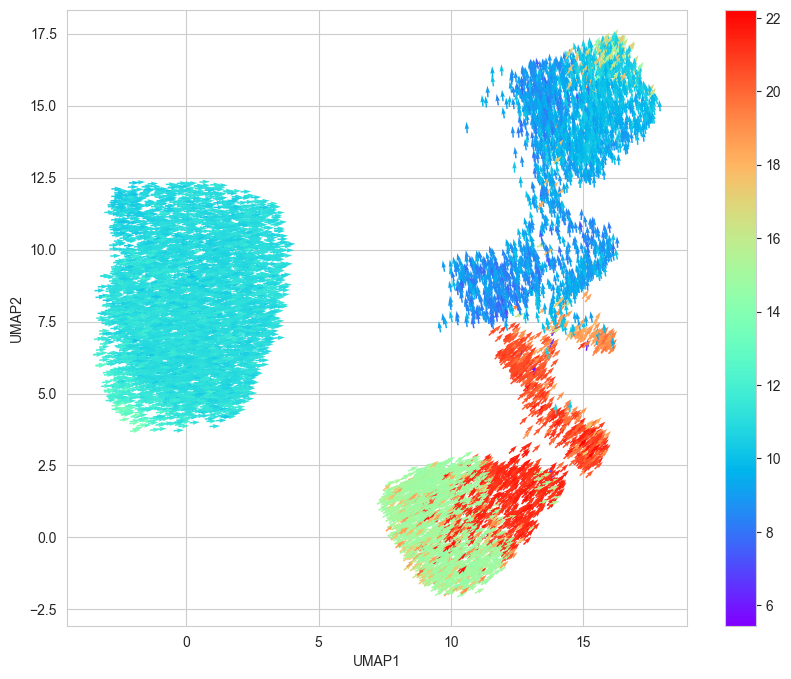

CPU times: user 1.08 s, sys: 98.6 ms, total: 1.17 s
Wall time: 567 ms


<Figure size 640x480 with 0 Axes>

In [93]:
%%time
scegot.plot_cell_velocity(
    velocities_umap,
    mode="umap",
    cmap="rainbow",
    save=True,
    save_path="./output/library/cell_velocity_umap.png",
)

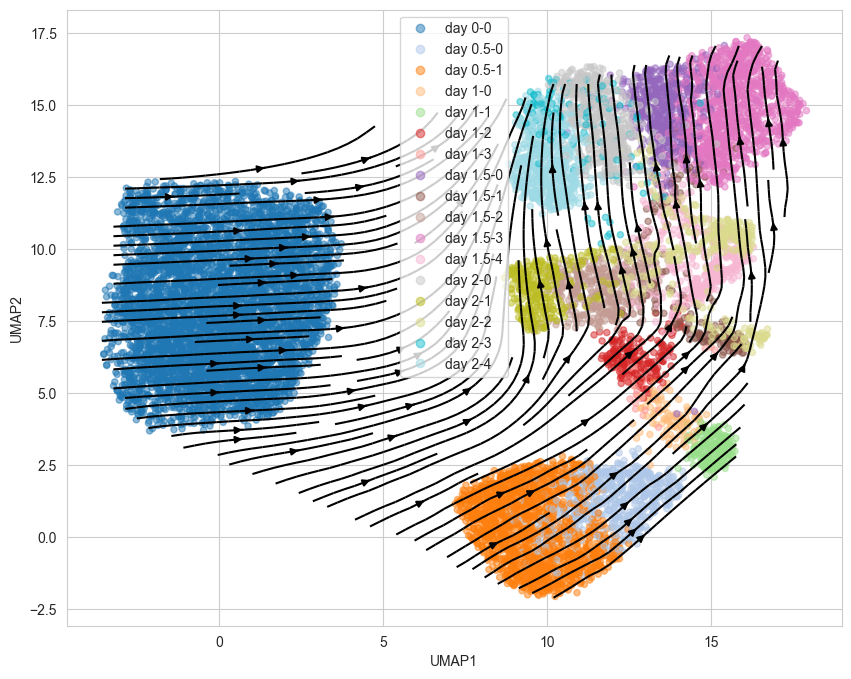

<Figure size 640x480 with 0 Axes>

In [94]:
scegot.plot_interpolation_of_cell_velocity(
    velocities_umap,
    mode="umap",
    cluster_names=list(itertools.chain.from_iterable(cluster_names)),
    cmap="tab20",
    save=True,
    save_path="./output/library/cell_velocity_interpolation_UMAP_gmm_clusters_all_days.png",
)

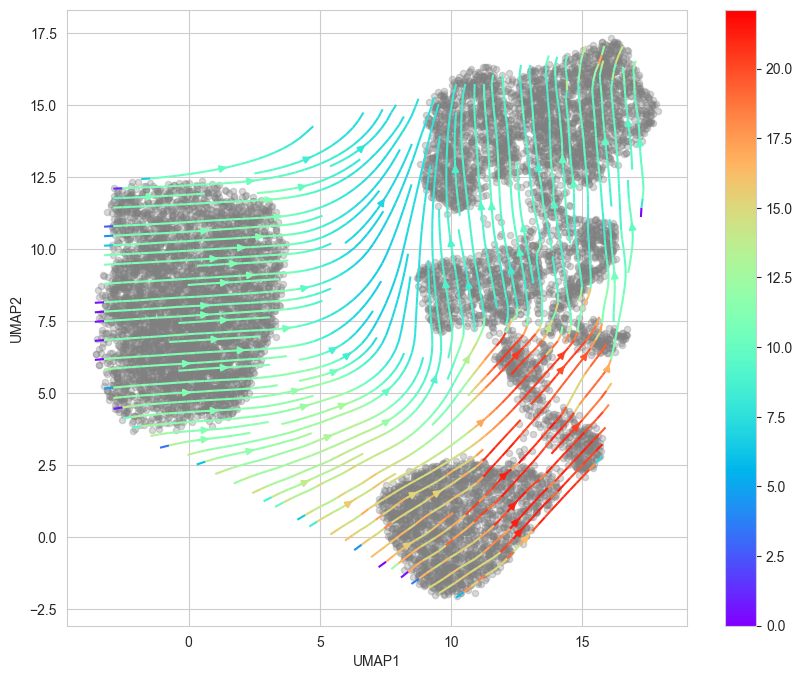

<Figure size 640x480 with 0 Axes>

In [95]:
scegot.plot_interpolation_of_cell_velocity(
    velocities_umap,
    mode="umap",
    color_streams=True,
    color_points=None,
    cmap="rainbow",
    save=True,
    save_path="./output/library/cell_velocity_interpolation_UMAP_all_days.png",
)

## GRN

In [97]:
%%time
GRNs, ridgeCVs = scegot.calculate_grns()

Calculating GRNs between each day...


 50%|█████     | 2/4 [00:09<00:09,  4.81s/it]/Users/momo/dev/ASHBi/scEGOT/scEGOT/scEGOT/scegot.py:1432: RuntimeWarning:

divide by zero encountered in log

/Users/momo/dev/ASHBi/scEGOT/scEGOT/scEGOT/scegot.py:1432: RuntimeWarning:

divide by zero encountered in log

/Users/momo/dev/ASHBi/scEGOT/scEGOT/scEGOT/scegot.py:1432: RuntimeWarning:

divide by zero encountered in log

 75%|███████▌  | 3/4 [00:11<00:03,  3.52s/it]/Users/momo/dev/ASHBi/scEGOT/scEGOT/scEGOT/scegot.py:1432: RuntimeWarning:

divide by zero encountered in log

/Users/momo/dev/ASHBi/scEGOT/scEGOT/scEGOT/scegot.py:1432: RuntimeWarning:

divide by zero encountered in log

/Users/momo/dev/ASHBi/scEGOT/scEGOT/scEGOT/scegot.py:1432: RuntimeWarning:

divide by zero encountered in log

100%|██████████| 4/4 [00:14<00:00,  3.67s/it]

CPU times: user 1min 21s, sys: 1.77 s, total: 1min 23s
Wall time: 14.7 s


alpha = 0.11288378916846889


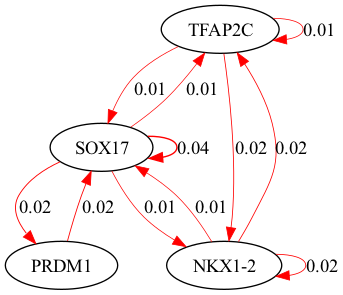

alpha = 37.92690190732246


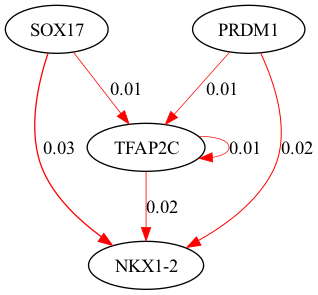

alpha = 23.357214690901213


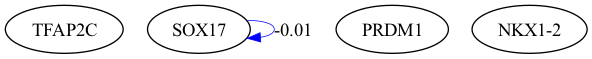

alpha = 100.0


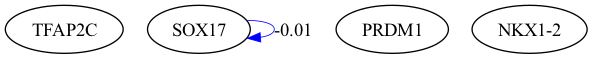

In [99]:
selected_genes = ["TFAP2C", "SOX17", "PRDM1", "NKX1-2"]
scegot.plot_grn_graph(
    GRNs,
    ridgeCVs,
    selected_genes,
    thresh=0.01,
    save=True,
    save_paths=[
        f"./output/library/GRN_{DAY_NAMES[i]}_to_{DAY_NAMES[i + 1]}.png"
        for i in range(len(DAY_NAMES) - 1)
    ],
)

## Waddington Landscape

In [100]:
%%time
Wpotential, F_all = scegot.calculate_waddington_potential()

Calculating F between each day...


100%|██████████| 4/4 [00:57<00:00, 14.34s/it]


Applying knn ...
Computing kernel ...


/Users/momo/.pyenv/versions/3.8.16/envs/scEGOT/lib/python3.8/site-packages/scipy/sparse/_index.py:146: SparseEfficiencyWarning:

Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.



CPU times: user 6min 35s, sys: 14.9 s, total: 6min 50s
Wall time: 1min


In [101]:
scegot.plot_waddington_potential(Wpotential)

In [102]:
gene_name = "NKX1-2"
scegot.plot_waddington_potential(
    Wpotential,
    gene_name,
    save=True,
    save_path="./output/library/waddington_potential.html",
)

In [103]:
scegot.plot_waddington_potential_surface(
    Wpotential,
    save=True,
    save_path="./output/library/waddington_potential_surface.html",
)